In [1]:
import pandas as pd
import numpy as np
from utility_functions import log_progress
import matplotlib.pyplot as plt

MODEL_PATH = "../models/train_model_is_balanced_15_epochs_2021_06_28-18_06_47"
IMAGE_SIZE = (600, 700)
NB_IMAGES_TO_DL = 50
IS_LAYER_MODEL = False
PEOPLE_PRED_VALUE = 0
DATASET_SIZE = NB_IMAGES_TO_DL

In [2]:
df = pd.read_csv('../data/raw/RAISE_1k.csv')
df["Class"] = df["Keywords"].map(lambda keywordsStr : 'people' if 'people' in keywordsStr else 'not_people')
df["FileName"] = df["File"].map(lambda file_name :  file_name + ".tif")
df = df[["FileName", "TIFF", "Class"]]
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   FileName  1000 non-null   object
 1   TIFF      1000 non-null   object
 2   Class     1000 non-null   object
dtypes: object(3)
memory usage: 23.6+ KB


In [3]:
df_final = df[df["Class"] == "people"][:DATASET_SIZE]
#df_final

In [4]:
def get_file_path(file_name):
    return "../data/raw/pictures/" + file_name

In [5]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.inception_v3 import preprocess_input

In [6]:
images = []
for index, row in log_progress(df_final.iterrows(), size=DATASET_SIZE):
    img = image.load_img(get_file_path(row["FileName"]), target_size=IMAGE_SIZE)
    images.append(image.img_to_array(img))
preprocessed_images = preprocess_input(np.array(images))
#print(preprocessed_images.shape)

In [7]:
from tensorflow import keras

In [ ]:
model = keras.models.load_model(MODEL_PATH)
#print("Model structure: ", model.summary())

In [9]:
predictions = model.predict(preprocessed_images, batch_size=10, verbose=1)
#predictions

50/50 [==============================] - 88s 2s/sample


In [10]:
predictions = np.where(predictions > 0.5, PEOPLE_PRED_VALUE, 1-PEOPLE_PRED_VALUE)
print("Accuracy: {}".format(sum(predictions)[0]/len(predictions)))

Accuracy: 0.04


In [11]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D

In [12]:
dense_layer = model.layers[-1]
dense_layer_weights = dense_layer.get_weights()
dense_layer_weights[0].shape
formatted_weights = (np.array([[dense_layer_weights[0]]]), dense_layer_weights[1])
prediction_outputs = Conv2D(1, (1,1), activation='sigmoid', weights=formatted_weights, name='conv_predictor')(model.layers[-3].output)
prediction_model = Model(inputs=model.inputs, outputs=prediction_outputs)
prediction_model.compile(optimizer='adam', loss='binary_crossentropy')

In [13]:
from skimage.filters import threshold_otsu
def adaptive_threshold(prediction):
    threshold =  threshold_otsu(prediction)
    rows, columns, _ = prediction.shape
    for row in range(rows):
        for column in range (columns):
            if prediction[row][column] > threshold:
                prediction[row][column] = 0
            else: 
                prediction[row][column] = 1
    prediction_np = np.where(predictions > threshold, PEOPLE_PRED_VALUE, 1-PEOPLE_PRED_VALUE)
    return prediction, prediction_np

In [14]:
import skimage.transform as st
def get_img_colored(img, predictions):
    def to_red_green(x):
        if PEOPLE_PRED_VALUE == 0:
            color_x = np.array([0, 255, 0])
            color_1_x = np.array([255, 0, 0])
        else:
            color_x = np.array([255, 0, 0])
            color_1_x = np.array([0, 255, 0])
        return x * color_x + (1-x) * color_1_x
    red_green_img = np.array([[to_red_green(x) for x in row] for row in predictions])
    red_green_img_resized = 255*st.resize(red_green_img.astype('uint8'), IMAGE_SIZE)

    colored_image = 0.5*np.asarray(img) + 0.5*red_green_img_resized
    return colored_image.astype('uint8')

In [15]:
predictions_new_model = prediction_model.predict(preprocessed_images, batch_size=10, verbose=1)

50/50 [==============================] - 76s 2s/sample


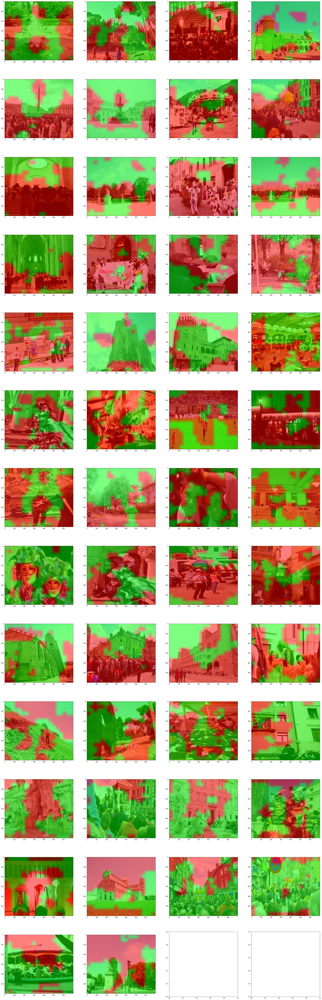

In [18]:
from math import ceil 
NB_IMAGES_PER_ROW = 4
fig, axes = plt.subplots(nrows=ceil(NB_IMAGES_TO_DL/NB_IMAGES_PER_ROW), ncols=NB_IMAGES_PER_ROW, figsize=(NB_IMAGES_PER_ROW*10,ceil(NB_IMAGES_TO_DL/NB_IMAGES_PER_ROW)*10))
plt.figure(1)
for i, pred in enumerate(predictions_new_model):
    #formatted_prediction = np.where(pred > 0.5, PEOPLE_PRED_VALUE, 1-PEOPLE_PRED_VALUE)
    thresh_pred, thresh_pred_np = adaptive_threshold(pred)
    img = image.load_img(get_file_path(df_final.iloc[i]["FileName"]), target_size=IMAGE_SIZE)
    colored_image = get_img_colored(img, thresh_pred)
    #colored_image_np = get_img_colored(img, thresh_pred_np)
    axes[i//NB_IMAGES_PER_ROW, i%NB_IMAGES_PER_ROW].imshow(colored_image)
    #axes[i//NB_IMAGES_PER_ROW, i%NB_IMAGES_PER_ROW].imshow(colored_image_np)